<a href="https://colab.research.google.com/github/konucha/SentimentAnalisis/blob/main/geosc.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Geopandas

In [ ]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Import Library

In [ ]:
import matplotlib.pyplot as plt
import numpy as np 
import pandas as pd


from shapely.geometry import Point,Polygon
import geopandas as gpd
import descartes

In [ ]:
gpd.__version__

'0.10.2'

# Connect Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
path = '/content/drive/My Drive/Colab Notebooks/Data geosc/'

# Read Data Riau Hotspot CSV

In [ ]:
df = pd.read_csv(path+'dataset-b.csv')

In [ ]:
df.head()

,Provinsi,Kab Kota,Kecamatan,Desa,Tanggal,Waktu,Satelit,Confidence,Latitude,Longitude
0,Riau,ROKAN HILIR,Kubu,Tanjungleban,10/7/2022,01:37 WIB,SNPP,High,2.018461,100.559524
1,Riau,KAMPAR,Koto Kampar Hulu,Gunung Malelo,29-03-2022,13:41 WIB,TERRA/AQUA,High,0.325179,100.557587
2,Riau,ROKAN HULU,Rambah Samo,Marga Mulya,27-03-2022,12:51 WIB,NOAA20,High,0.780777,100.354240
3,Riau,INDRAGIRI HULU,KECAMATAN PASIR PENYU,JAPURA,30-07-2021,12:50 WIB,NOAA20,High,-0.418621,102.315361
4,Riau,ROKAN HILIR,Pasir Limau Kapas,Sungai Daun,10/7/2022,13:31 WIB,NASA-NOAA20,High,2.075270,100.412280


In [ ]:
df.shape

(50560, 10)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50560 entries, 0 to 50559
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Provinsi    50560 non-null  object 
 1   Kab Kota    50560 non-null  object 
 2   Kecamatan   50558 non-null  object 
 3   Desa        50487 non-null  object 
 4   Tanggal     50560 non-null  object 
 5   Waktu       50560 non-null  object 
 6   Satelit     50560 non-null  object 
 7   Confidence  50560 non-null  object 
 8   Latitude    50560 non-null  float64
 9   Longitude   50560 non-null  float64
dtypes: float64(2), object(8)
memory usage: 3.9+ MB


# Read Data Riau Hotspot SHP

In [ ]:
data_gpd = gpd.read_file(path+"dataset-geo.shp")

In [ ]:
data_gpd.shape

(50560, 11)

In [ ]:
data_gpd.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
data_gpd.head()

,Provinsi,Kab Kota,Kecamatan,Desa,Tanggal,Waktu,Satelit,Confidence,Latitude,Longitude,geometry
0,Riau,ROKAN HILIR,Kubu,Tanjungleban,10/7/2022,01:37 WIB,SNPP,High,2.018461,100.559524,POINT (100.55952 2.01846)
1,Riau,KAMPAR,Koto Kampar Hulu,Gunung Malelo,29-03-2022,13:41 WIB,TERRA/AQUA,High,0.325179,100.557587,POINT (100.55759 0.32518)
2,Riau,ROKAN HULU,Rambah Samo,Marga Mulya,27-03-2022,12:51 WIB,NOAA20,High,0.780777,100.354240,POINT (100.35424 0.78078)
3,Riau,INDRAGIRI HULU,KECAMATAN PASIR PENYU,JAPURA,30-07-2021,12:50 WIB,NOAA20,High,-0.418621,102.315361,POINT (102.31536 -0.41862)
4,Riau,ROKAN HILIR,Pasir Limau Kapas,Sungai Daun,10/7/2022,13:31 WIB,NASA-NOAA20,High,2.075270,100.412280,POINT (100.41228 2.07527)


Text(0.5, 70.74411394147002, 'Longitude')

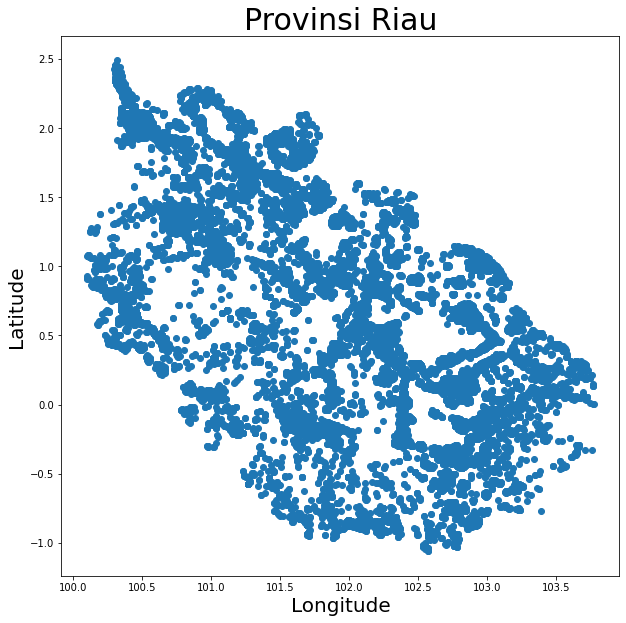

In [ ]:
fig, ax = plt.subplots(figsize = (10,10))
data_gpd.plot(ax=ax)
ax.set_title('Provinsi Riau',fontdict = {'fontsize': 30})
ax.set_ylabel('Latitude',fontdict = {'fontsize': 20})
ax.set_xlabel('Longitude',fontdict = {'fontsize': 20})

# Read Data Peta Riau SHP

In [ ]:
dataset_riau = gpd.read_file(path+'prov_riau_ar_140020180328185155.shp')

In [ ]:
dataset_riau.shape

(12, 7)

In [ ]:
dataset_riau.crs

<Geographic 2D CRS: GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84" ...>
Name: WGS 84
Axis Info [ellipsoidal]:
- lon[east]: Longitude (degree)
- lat[north]: Latitude (degree)
Area of Use:
- undefined
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
dataset_riau.head()

,objectid_1,objectid,kabupaten,shape_leng,shape_le_1,shape_area,geometry
0,1.0,1.0,KABUPATEN BENGKALIS,852320.384083,7.676816,0.691465,"MULTIPOLYGON Z (((102.42423 1.53024 0.00000, 1..."
1,2.0,2.0,KABUPATEN INDRAGIRI HILIR,998143.200756,8.971353,1.089066,"MULTIPOLYGON Z (((102.60722 -1.10193 0.00000, ..."
2,3.0,3.0,KABUPATEN INDRAGIRI HULU,493305.955373,4.443123,0.646503,"MULTIPOLYGON Z (((101.84566 -0.98343 0.00000, ..."
3,4.0,4.0,KABUPATEN KAMPAR,783998.243830,7.065890,0.884836,"POLYGON Z ((101.30208 0.79564 0.00000, 101.306..."
4,5.0,5.0,KABUPATEN KEPULAUAN MERANTI,616578.117518,5.546621,0.294526,"MULTIPOLYGON Z (((102.89170 0.77292 0.00000, 1..."


Text(0.5, 69.0, 'Longitude')

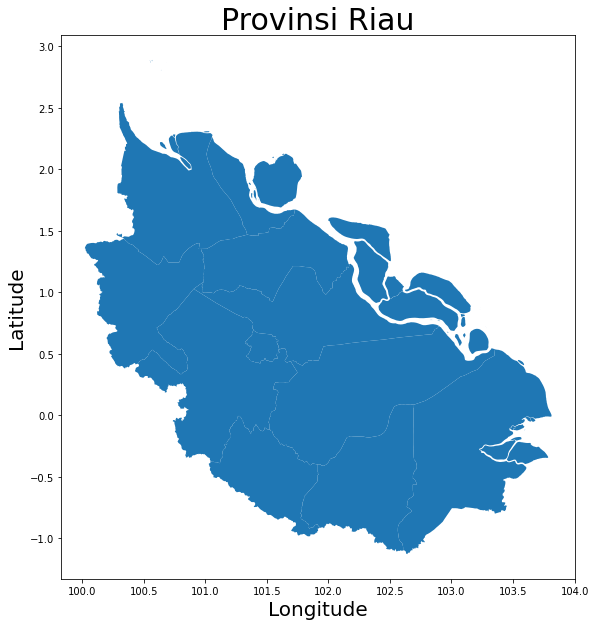

In [ ]:
fig, ax = plt.subplots(figsize = (10,10))
dataset_riau.plot(ax=ax)
ax.set_title('Provinsi Riau',fontdict = {'fontsize': 30})
ax.set_ylabel('Latitude',fontdict = {'fontsize': 20})
ax.set_xlabel('Longitude',fontdict = {'fontsize': 20})

# Distinct Data Kabupaten

In [ ]:
city = df.groupby(['Kab Kota']).sum()
city

,Latitude,Longitude
Kab Kota,,
BENGKALIS,10458.969402,676134.592290
DUMAI,4933.493254,291813.615683
INDRAGIRI HILIR,-2132.643364,853964.416966
INDRAGIRI HULU,-1540.682989,298372.849140
KAMPAR,373.469553,132243.935205
KEPULAUAN MERANTI,3880.039435,400356.542442
KOTA DUMAI,527.868911,32569.139666
KOTA PEKANBARU,37.110338,6998.135400
KUANTAN SINGINGI,-386.277183,69245.674825


# Pembagian Kabupaten di Riau

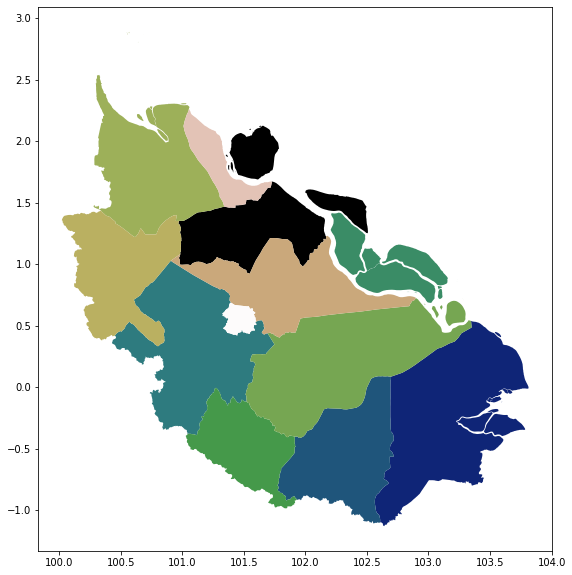

In [ ]:
# left = ['KABUPATEN BENGKALIS','KABUPATEN INDRAGIRI HILIR']
# center = ['KABUPATEN INDRAGIRI HULU','KABUPATEN KAMPAR','KABUPATEN KEPULAUAN MERANTI',
#           'KABUPATEN KUANTAN SINGINGI','KABUPATEN PELALAWAN','KABUPATEN ROKAN HILIR',
#           'KABUPATEN ROKAN HULU','KABUPATEN SIAK'] 
# right = ['KOTA DUMAI','KOTA PEKANBARU']

dataset_riau.plot(figsize = (10,10),cmap = 'gist_earth')
# for idx, row in dataset_riau.iterrows():
#   if row['kabupaten'] in left:
#     plt.show()
#   elif row['kabupaten'] in center:
#     plt.show()
#   elif row['kabupaten'] in right:
#     plt.show()
        
# plt.title('School Districts in Kings County, WA', fontdict = {'fontsize': 20})
# plt.ylabel('Latitude',fontdict = {'fontsize': 20})
# plt.xlabel('Longitude',fontdict = {'fontsize': 20})

# Plot Hotspot dan Peta Riau

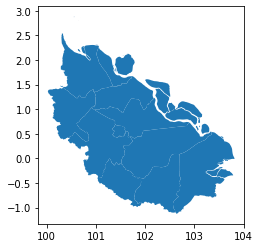

In [ ]:
riau = dataset_riau.plot()
riau

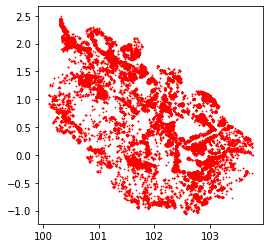

In [ ]:
riau_gpd = data_gpd.plot(c='r', markersize=0.5)
riau_gpd

# Pencarian Data Berdasarkan Kota Kab

In [ ]:
data_kampar = df.groupby('Kab Kota') 
get_data = data_kampar.get_group('KAMPAR')
get_data

,Provinsi,Kab Kota,Kecamatan,Desa,Tanggal,Waktu,Satelit,Confidence,Latitude,Longitude
1,Riau,KAMPAR,Koto Kampar Hulu,Gunung Malelo,29-03-2022,13:41 WIB,TERRA/AQUA,High,0.325179,100.557587
16,Riau,KAMPAR,Koto Kampar Hulu,Siberuang,27-03-2022,05:59 WIB,NASA-NOAA20,High,0.509900,100.594480
18,Riau,KAMPAR,KECAMATAN XIII KOTO KAMPAR,BENCAH KESUMA,21-07-2021,13:59 WIB,TERRA/AQUA,High,0.454569,100.648224
21,Riau,KAMPAR,Xiii Koto Kampar,Balung,18-05-2022,07:14 WIB,NASA-SNPP,High,0.126900,100.816830
37,Riau,KAMPAR,Koto Kampar Hulu,Siberuang,27-03-2022,12:51 WIB,NOAA20,High,0.509667,100.593483
...,...,...,...,...,...,...,...,...,...,...
50313,Riau,KAMPAR,KECAMATAN XIII KOTO KAMPAR,SIBIRUANG,10/8/2016,06:47 WIB,TERRA/AQUA,High,0.333254,100.560631
50420,Riau,KAMPAR,KECAMATAN KAMPAR KIRI HULU,KEBUN TINGGI,16-08-2016,15:38 WIB,TERRA/AQUA,Medium,-0.041608,100.785423
50490,Riau,KAMPAR,KECAMATAN KAMPAR KIRI HULU,TANJUNG KARANG,6/8/2016,07:11 WIB,TERRA/AQUA,High,-0.126056,100.843155
50491,Riau,KAMPAR,KECAMATAN KAMPAR KIRI HULU,BATU SASAK,6/8/2016,04:20 WIB,TERRA/AQUA,Medium,-0.034971,100.817566


# Pre-Processing Data

In [ ]:
dataset_riau.columns

Index(['objectid_1', 'objectid', 'kabupaten', 'shape_leng', 'shape_le_1',
       'shape_area', 'geometry'],
      dtype='object')

In [ ]:
data_gpd.columns

Index(['Provinsi', 'Kab Kota', 'Kecamatan', 'Desa', 'Tanggal', 'Waktu',
       'Satelit', 'Confidence', 'Latitude', 'Longitude', 'geometry'],
      dtype='object')

Text(0.5, 69.0, 'Longitude')

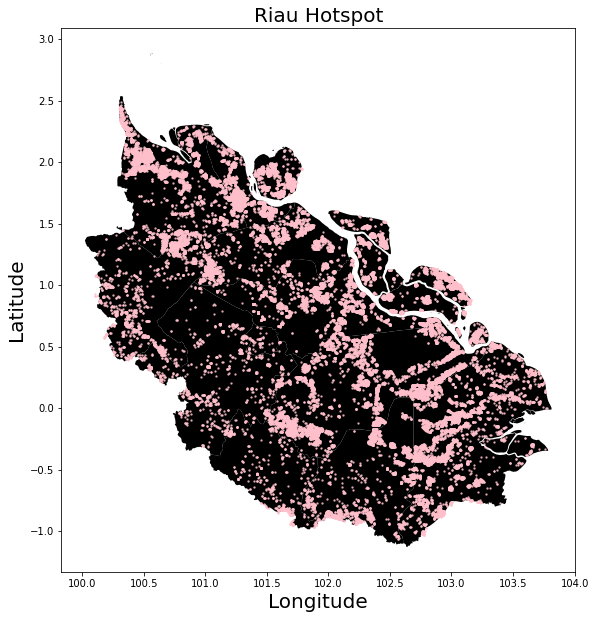

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
dataset_riau.plot(ax=ax, color='black')
data_gpd.plot(ax=ax, alpha=0.7, color='pink', markersize=2)
ax.set_title('Riau Hotspot', fontdict = {'fontsize': 20})
ax.set_ylabel('Latitude',fontdict = {'fontsize': 20})
ax.set_xlabel('Longitude',fontdict = {'fontsize': 20})

In [ ]:
# fig, ax = plt.subplots(2, 2, figsize=(15, 15))

# # ax.subplot(2,3,1)
# dataset_riau.plot(ax=ax[0,0], color='black')
# data_gpd[data_gpd['Confidence']=='High'].plot(ax=ax[0, 0], alpha=0.7, color='red', markersize=1, label='Confidence High')
# plt.title('Confidence High', fontdict = {'fontsize': 20})
# plt.ylabel('Latitude',fontdict = {'fontsize': 20})
# plt.xlabel('Longitude',fontdict = {'fontsize': 20})

# # plt.subplot(2,3,2)
# dataset_riau.plot(ax=ax[0,1], color='black')
# data_gpd[data_gpd['Confidence']=='Medium'].plot(ax=ax[0,1], alpha=0.7, color='yellow', markersize=1, label='Confidence Medium')
# # ax.set_title('Confidence Medium', fontdict = {'fontsize': 20})
# # ax.set_ylabel('Latitude',fontdict = {'fontsize': 20})
# # ax.set_xlabel('Longitude',fontdict = {'fontsize': 20})

# # plt.subplot(2,3,3)
# dataset_riau.plot(ax=ax[1,0], color='black')
# data_gpd[data_gpd['Confidence']=='Low'].plot(ax=ax[1, 0], alpha=0.7, color='green', markersize=1, label='Confidence Low')
# # ax.set_title('Confidence Low', fontdict = {'fontsize': 20})
# # ax.set_ylabel('Latitude',fontdict = {'fontsize': 20})
# # ax.set_xlabel('Longitude',fontdict = {'fontsize': 20})

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous ax

Text(932.514705882353, 0.5, 'Longitude')

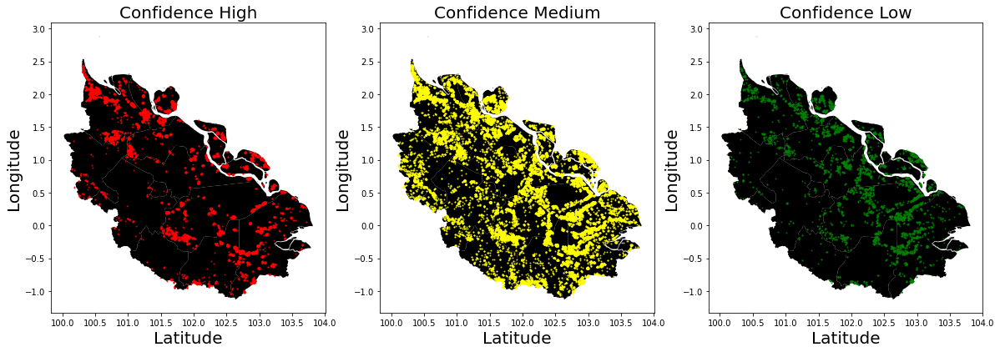

In [ ]:
plt.figure(figsize=(20,20))
ax = plt.axes()

dataset_riau.plot(ax=(plt.subplot(2,3,1)), color='black')
data_gpd[data_gpd['Confidence']=='High'].plot(ax=plt.subplot(2,3,1), alpha=0.7, color='red', markersize=1, label='Confidence High')
plt.title('Confidence High', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

dataset_riau.plot(ax=(plt.subplot(2,3,2)), color='black')
data_gpd[data_gpd['Confidence']=='Medium'].plot(ax=plt.subplot(2,3,2), alpha=0.7, color='yellow', markersize=1, label='Confidence Medium')
plt.title('Confidence Medium', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

dataset_riau.plot(ax=(plt.subplot(2,3,3)), color='black')
data_gpd[data_gpd['Confidence']=='Low'].plot(ax=plt.subplot(2,3,3), alpha=0.7, color='green', markersize=1, label='Confidence Low')
plt.title('Confidence Low', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})


# Data Per Tahun

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50560 entries, 0 to 50559
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Provinsi    50560 non-null  object 
 1   Kab Kota    50560 non-null  object 
 2   Kecamatan   50558 non-null  object 
 3   Desa        50487 non-null  object 
 4   Tanggal     50560 non-null  object 
 5   Waktu       50560 non-null  object 
 6   Satelit     50560 non-null  object 
 7   Confidence  50560 non-null  object 
 8   Latitude    50560 non-null  float64
 9   Longitude   50560 non-null  float64
dtypes: float64(2), object(8)
memory usage: 3.9+ MB


In [ ]:
df['Tanggal'] = pd.to_datetime(df['Tanggal'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50560 entries, 0 to 50559
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   Provinsi    50560 non-null  object        
 1   Kab Kota    50560 non-null  object        
 2   Kecamatan   50558 non-null  object        
 3   Desa        50487 non-null  object        
 4   Tanggal     50560 non-null  datetime64[ns]
 5   Waktu       50560 non-null  object        
 6   Satelit     50560 non-null  object        
 7   Confidence  50560 non-null  object        
 8   Latitude    50560 non-null  float64       
 9   Longitude   50560 non-null  float64       
dtypes: datetime64[ns](1), float64(2), object(7)
memory usage: 3.9+ MB


In [ ]:
df = pd.read_csv(path+'dataset-b.csv', parse_dates=['Tanggal'])
df['Tahun'] = df.Tanggal.dt.strftime('%Y')
print (df)

      Provinsi         Kab Kota                   Kecamatan           Desa  \
0         Riau      ROKAN HILIR                        Kubu   Tanjungleban   
1         Riau           KAMPAR            Koto Kampar Hulu  Gunung Malelo   
2         Riau       ROKAN HULU                 Rambah Samo    Marga Mulya   
3         Riau   INDRAGIRI HULU       KECAMATAN PASIR PENYU         JAPURA   
4         Riau      ROKAN HILIR           Pasir Limau Kapas    Sungai Daun   
...        ...              ...                         ...            ...   
50555     Riau             SIAK            KECAMATAN PUSAKA          DOSAN   
50556     Riau  INDRAGIRI HILIR             KECAMATAN GAUNG   TELUK BINJAI   
50557     Riau       ROKAN HULU  KECAMATAN BONAI DARUSSALAM          BONAI   
50558     Riau  INDRAGIRI HILIR             KECAMATAN GAUNG   TELUK BINJAI   
50559     Riau      ROKAN HILIR     KECAMATAN BANGKO PUSAKO  TELUK BANO II   

         Tanggal      Waktu      Satelit Confidence  Latitude  

In [ ]:
data_gpd = gpd.read_file(path+"dataset-geo.shp", parse_dates=['Tanggal'])
data_gpd['Tahun'] = df.Tanggal.dt.strftime('%Y')
data_gpd

,Provinsi,Kab Kota,Kecamatan,Desa,Tanggal,Waktu,Satelit,Confidence,Latitude,Longitude,geometry,Tahun
0,Riau,ROKAN HILIR,Kubu,Tanjungleban,10/7/2022,01:37 WIB,SNPP,High,2.018461,100.559524,POINT (100.55952 2.01846),2022
1,Riau,KAMPAR,Koto Kampar Hulu,Gunung Malelo,29-03-2022,13:41 WIB,TERRA/AQUA,High,0.325179,100.557587,POINT (100.55759 0.32518),2022
2,Riau,ROKAN HULU,Rambah Samo,Marga Mulya,27-03-2022,12:51 WIB,NOAA20,High,0.780777,100.354240,POINT (100.35424 0.78078),2022
3,Riau,INDRAGIRI HULU,KECAMATAN PASIR PENYU,JAPURA,30-07-2021,12:50 WIB,NOAA20,High,-0.418621,102.315361,POINT (102.31536 -0.41862),2021
4,Riau,ROKAN HILIR,Pasir Limau Kapas,Sungai Daun,10/7/2022,13:31 WIB,NASA-NOAA20,High,2.075270,100.412280,POINT (100.41228 2.07527),2022
...,...,...,...,...,...,...,...,...,...,...,...,...
50555,Riau,SIAK,KECAMATAN PUSAKA,DOSAN,16-07-2016,04:05 WIB,NASA-MODIS,Medium,0.869000,102.144000,POINT (102.14400 0.86900),2016
50556,Riau,INDRAGIRI HILIR,KECAMATAN GAUNG,TELUK BINJAI,16-07-2016,04:05 WIB,NASA-MODIS,Low,0.106000,102.784000,POINT (102.78400 0.10600),2016
50557,Riau,ROKAN HULU,KECAMATAN BONAI DARUSSALAM,BONAI,16-07-2016,04:05 WIB,NASA-MODIS,Medium,1.200000,100.910000,POINT (100.91000 1.20000),2016
50558,Riau,INDRAGIRI HILIR,KECAMATAN GAUNG,TELUK BINJAI,16-07-2016,04:01 WIB,TERRA/AQUA,Medium,0.106254,102.784233,POINT (102.78423 0.10625),2016


In [ ]:
data_gpd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 50560 entries, 0 to 50559
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   Provinsi    50560 non-null  object  
 1   Kab Kota    50560 non-null  object  
 2   Kecamatan   50558 non-null  object  
 3   Desa        50487 non-null  object  
 4   Tanggal     50560 non-null  object  
 5   Waktu       50560 non-null  object  
 6   Satelit     50560 non-null  object  
 7   Confidence  50560 non-null  object  
 8   Latitude    50560 non-null  float64 
 9   Longitude   50560 non-null  float64 
 10  geometry    50560 non-null  geometry
 11  Tahun       50560 non-null  object  
dtypes: float64(2), geometry(1), object(9)
memory usage: 4.6+ MB


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous ax

Text(157.82965044382013, 0.5, 'Longitude')

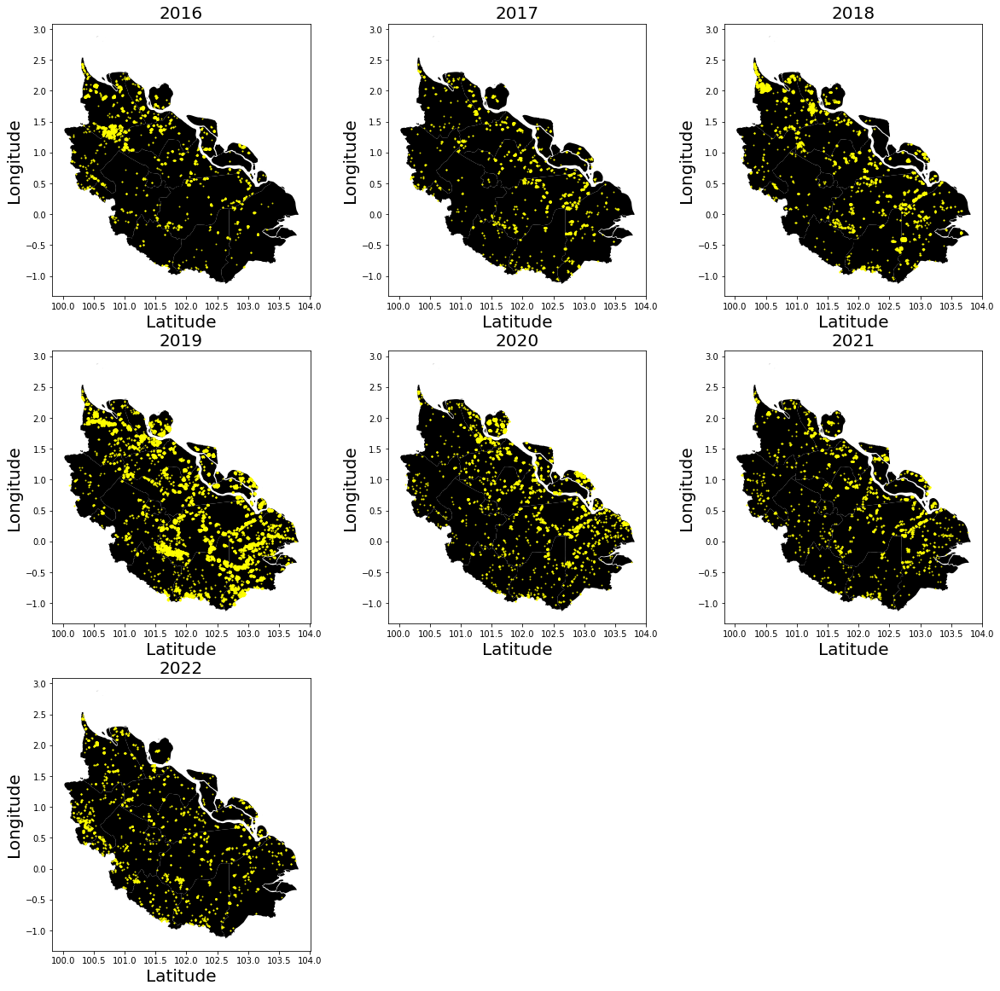

In [ ]:
plt.figure(figsize=(20,20))
ax = plt.axes()

dataset_riau.plot(ax=(plt.subplot(3,3,1)), color='black')
data_gpd[data_gpd['Tahun']=='2016'].plot(ax=plt.subplot(3,3,1), alpha=0.7, color='yellow', markersize=1, label='2016')
plt.title('2016', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

dataset_riau.plot(ax=(plt.subplot(3,3,2)), color='black')
data_gpd[data_gpd['Tahun']=='2017'].plot(ax=plt.subplot(3,3,2), alpha=0.7, color='yellow', markersize=1, label='2017')
plt.title('2017', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

dataset_riau.plot(ax=(plt.subplot(3,3,3)), color='black')
data_gpd[data_gpd['Tahun']=='2018'].plot(ax=plt.subplot(3,3,3), alpha=0.7, color='yellow', markersize=1, label='2018')
plt.title('2018', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

dataset_riau.plot(ax=(plt.subplot(3,3,4)), color='black')
data_gpd[data_gpd['Tahun']=='2019'].plot(ax=plt.subplot(3,3,4), alpha=0.7, color='yellow', markersize=1, label='2019')
plt.title('2019', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

dataset_riau.plot(ax=(plt.subplot(3,3,5)), color='black')
data_gpd[data_gpd['Tahun']=='2020'].plot(ax=plt.subplot(3,3,5), alpha=0.7, color='yellow', markersize=1, label='2020')
plt.title('2020', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

dataset_riau.plot(ax=(plt.subplot(3,3,6)), color='black')
data_gpd[data_gpd['Tahun']=='2021'].plot(ax=plt.subplot(3,3,6), alpha=0.7, color='yellow', markersize=1, label='2021')
plt.title('2021', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

dataset_riau.plot(ax=(plt.subplot(3,3,7)), color='black')
data_gpd[data_gpd['Tahun']=='2022'].plot(ax=plt.subplot(3,3,7), alpha=0.7, color='yellow', markersize=1, label='2022')
plt.title('2022', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

# Lahan Gambut di Riau

In [ ]:
lahan_gambut = gpd.read_file(path+"PIBPIB_RIAU_XV.shp")

In [ ]:
lahan_gambut.head()

,NAME,KML_FOLDER,geometry
0,MOR_GAMBUT,PIPPIB REVISI XV,"POLYGON ((103.33574 0.02492, 103.33589 0.02453..."
1,MOR_GAMBUT,PIPPIB REVISI XV,"POLYGON ((103.11159 -0.28988, 103.11067 -0.289..."
2,MOR_GAMBUT,PIPPIB REVISI XV,"POLYGON ((103.45861 -0.27045, 103.45829 -0.271..."
3,MOR_GAMBUT,PIPPIB REVISI XV,"POLYGON ((103.40201 -0.26752, 103.40176 -0.270..."
4,MOR_GAMBUT,PIPPIB REVISI XV,"POLYGON ((103.47314 -0.26815, 103.47289 -0.268..."


In [ ]:
lahan_gambut.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


Text(447.44625693590405, 0.5, 'Longitude')

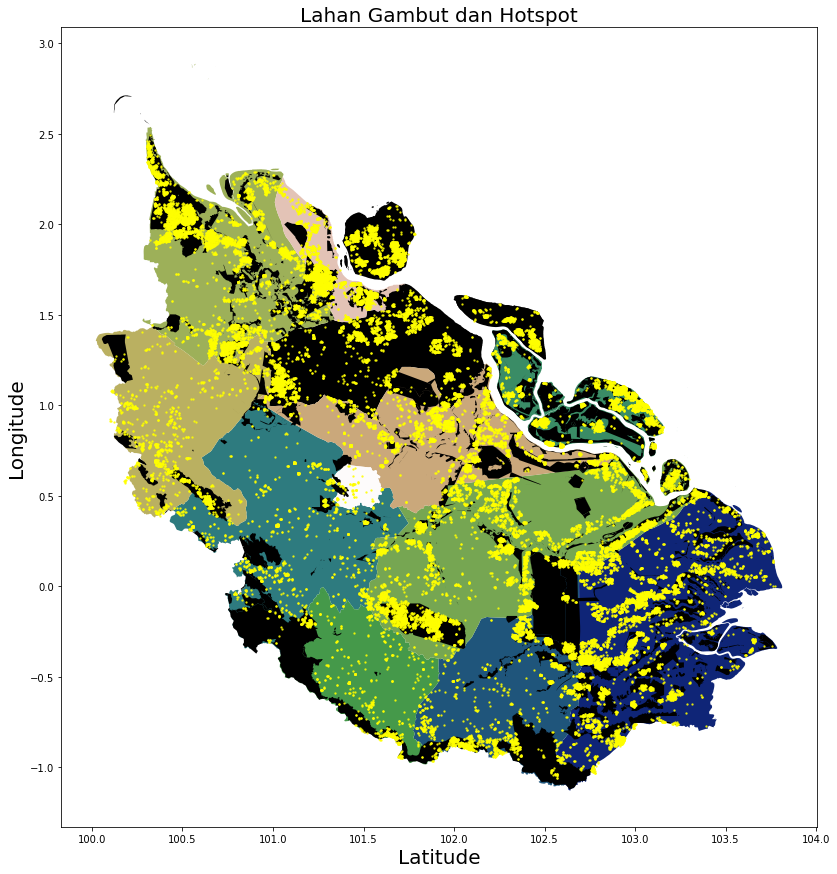

In [ ]:
plt.figure(figsize=(50,50))
ax = plt.axes()

dataset_riau.plot(ax=(plt.subplot(3,3,1)), color='pink', cmap = 'gist_earth')
lahan_gambut.plot(ax=(plt.subplot(3,3,1)), color='black')
data_gpd.plot(ax=plt.subplot(3,3,1), alpha=0.7, color='yellow', markersize=2, label='Lahan Gambut')
plt.title('Lahan Gambut dan Hotspot', fontdict={'fontsize': 20})
plt.xlabel('Latitude', fontdict={'fontsize': 20})
plt.ylabel('Longitude', fontdict={'fontsize': 20})

# 3D Modelling Map

In [ ]:
!pip install pydeck

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pydeck as pdk

HEXAGON_LAYER_DATA = pd.read_csv(path+'dataset-b.csv')

# Define a layer to display on a map
layer = pdk.Layer(
    "HexagonLayer",
    HEXAGON_LAYER_DATA,
    get_position=["Longitude", "Latitude"],
    auto_highlight=True,
    elevation_scale=50,
    pickable=True,
    elevation_range=[0, 3000],
    extruded=True,
    coverage=1,
)

# Set the viewport location
view_state = pdk.ViewState(
    longitude=101.7068294, latitude=0.2933469, zoom=6, min_zoom=5, max_zoom=15, pitch=40.5, bearing=-27.36,
)

# Render
r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r.to_html("hexagon_layer.html")

<IPython.core.display.Javascript object>

'<!DOCTYPE html>\n<html>\n  <head>\n    <meta http-equiv="content-type" content="text/html; charset=UTF-8" />\n    <title>pydeck</title>\n        <script src="https://api.tiles.mapbox.com/mapbox-gl-js/v1.13.0/mapbox-gl.js"></script>\n        <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/3.2.0/css/bootstrap-theme.min.css" />\n    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/font-awesome/4.6.3/css/font-awesome.min.css" />\n    <script src=\'https://cdn.jsdelivr.net/npm/@deck.gl/jupyter-widget@~8.5.*/dist/index.js\'></script>\n    <style>\n    body {\n  margin: 0;\n  padding: 0;\n  overflow: hidden;\n}\n\n#deck-map-container {\n  width: 100%;\n  height: 100%;\n  background-color: black;\n}\n\n#map {\n  pointer-events: none;\n  height: 100%;\n  width: 100%;\n  position: absolute;\n  z-index: 1;\n}\n\n#deckgl-overlay {\n  z-index: 2;\n  background: none;\n}\n\n#deck-map-wrapper {\n  width: 100%;\n  height: 100%;\n}\n\n#deck-container {\n  width: 100v

In [ ]:
HEXAGON_LAYER_DATA

'/content/drive/My Drive/Colab Notebooks/Data geosc/dataset-b.csv'